# Data Engineering Analysis

In [2]:
import os
import pandas as pd
import numpy as np
from sklearn.pipeline import Pipeline
import data_engineering
from sklearn.preprocessing import FunctionTransformer
import seaborn as sns
import matplotlib.pyplot as plt

In [3]:
# data path
data_path = "../data"

In [4]:
df_train = pd.read_csv(os.path.join(data_path, "train.csv"))
df_train.head()

,Id,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
0,242642,2881,130,22,210,54,1020,250,221,88,...,0,0,0,0,0,0,0,0,0,1
1,309891,3005,351,14,242,-16,1371,194,215,159,...,0,0,0,0,0,0,0,0,0,1
2,287847,3226,63,14,618,2,1092,232,210,107,...,0,0,0,0,0,0,0,0,0,1
3,516307,3298,317,8,661,60,752,198,233,174,...,0,0,0,0,0,0,0,0,0,1
4,124860,3080,35,6,175,26,3705,219,227,144,...,0,0,0,0,0,0,0,0,0,1


In [5]:
transformations = [
    ("euclidean_dist", FunctionTransformer(data_engineering.euclidean_dist)),
    ("linear_dist", FunctionTransformer(data_engineering.linear_dist)),
    ("mean_hillshade", FunctionTransformer(data_engineering.mean_hillshade)),
    ("morning_hillshade", FunctionTransformer(data_engineering.morning_hillshade)),
    ("mean_amenties", FunctionTransformer(data_engineering.mean_amenties)),
    ("aspect_dir", FunctionTransformer(data_engineering.aspect_dir)),
    ("climatic_zone", FunctionTransformer(data_engineering.climatic_zone)),
    ("geologic_zone", FunctionTransformer(data_engineering.geologic_zone)),
    ("soil_type", FunctionTransformer(data_engineering.soil_type)),
    ("scaling", FunctionTransformer(data_engineering.scaling)),
]

pipe = Pipeline(transformations)

In [6]:
pipe

Pipeline(steps=[('euclidean_dist',
                 FunctionTransformer(func=<function euclidean_dist at 0x7f8d19f184c0>)),
                ('linear_dist',
                 FunctionTransformer(func=<function linear_dist at 0x7f8d19f18550>)),
                ('mean_hillshade',
                 FunctionTransformer(func=<function mean_hillshade at 0x7f8d19f185e0>)),
                ('morning_hillshade',
                 FunctionTransformer(func=<function morning_hillshade at 0x7f8d19...
                 FunctionTransformer(func=<function aspect_dir at 0x7f8d19f18790>)),
                ('climatic_zone',
                 FunctionTransformer(func=<function climatic_zone at 0x7f8d19f18820>)),
                ('geologic_zone',
                 FunctionTransformer(func=<function geologic_zone at 0x7f8d19f188b0>)),
                ('soil_type',
                 FunctionTransformer(func=<function soil_type at 0x7f8d19f18940>)),
                ('scaling',
                 FunctionTransformer(func=<function scaling at 0x7f8d19f189d0>))])

In [7]:
df_final = pipe.fit_transform(df_train)

In [8]:
df_final

,Hyd_p_Road,Horizontal_Distance_To_Roadways,Vertical_Distance_To_Hydrology,Aspect,Horizontal_Distance_To_Hydrology,Hillshade_9am,Mean_Amenities,Hyd_m_Fire,Fire_m_Road,Elevation,...,Clim6,Clim7,Clim8,Geo1,Geo2,Geo5,Geo7,Soil_Stony,Soil_Rubly,Soil_Other
0,-0.516736,-0.524709,0.043699,-0.235412,-0.087846,1.206733,-0.880254,-1.072249,-0.245969,0.315874,...,0,1,0,0,0,0,1,1,0,0
1,-0.240462,-0.260842,-1.094171,1.778407,0.065125,-0.621098,-0.471536,-0.645128,-0.411164,0.611820,...,0,1,0,0,0,0,1,1,0,0
2,-0.170492,-0.470582,-0.801576,-0.845936,1.862539,0.619216,0.117703,0.084992,0.028986,1.139272,...,0,1,0,0,0,0,1,1,0,0
3,-0.384730,-0.726179,0.141231,1.468589,2.068094,-0.490539,-0.376184,-0.656993,-0.447751,1.311111,...,0,1,0,0,1,0,0,0,0,1
4,1.394819,1.493755,-0.411449,-1.101081,-0.255159,0.194898,1.425324,1.087082,0.146507,0.790820,...,0,1,0,0,0,0,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15115,2.514341,2.549220,-0.639023,1.505038,0.452334,-0.882217,2.364959,1.388257,1.173153,1.382711,...,0,0,1,0,0,0,1,1,0,0
15116,-0.119998,-0.585601,0.661400,-1.082856,2.928558,0.227538,-0.616416,-0.755559,-0.357947,1.685817,...,0,0,1,0,0,0,1,0,0,0
15117,-0.021174,-0.154093,1.002761,-0.599904,0.839543,0.880335,-0.024862,-0.189716,-0.986574,1.265765,...,0,1,0,0,0,0,1,1,0,0
15118,0.245001,0.112780,0.011188,1.833081,0.906468,-0.262060,0.217221,-0.061945,-0.763727,2.005629,...,0,0,1,0,0,0,1,0,0,0


In [9]:
print(df_final.columns)

Index(['Hyd_p_Road', 'Horizontal_Distance_To_Roadways',
       'Vertical_Distance_To_Hydrology', 'Aspect',
       'Horizontal_Distance_To_Hydrology', 'Hillshade_9am', 'Mean_Amenities',
       'Hyd_m_Fire', 'Fire_m_Road', 'Elevation', 'Slope', 'Hillshade_Noon',
       'Hillshade_3pm', 'Mean_Hillshade', 'Horizontal_Distance_To_Fire_Points',
       'Fire_p_Road', 'Hyd_p_Fire', 'Morning_Hillshade',
       'Distance_To_Hydrology', 'Hyd_m_Road', 'Wilderness_Area1',
       'Wilderness_Area2', 'Wilderness_Area3', 'Wilderness_Area4',
       'Soil_Type1', 'Soil_Type2', 'Soil_Type3', 'Soil_Type4', 'Soil_Type5',
       'Soil_Type6', 'Soil_Type7', 'Soil_Type8', 'Soil_Type9', 'Soil_Type10',
       'Soil_Type11', 'Soil_Type12', 'Soil_Type13', 'Soil_Type14',
       'Soil_Type15', 'Soil_Type16', 'Soil_Type17', 'Soil_Type18',
       'Soil_Type19', 'Soil_Type20', 'Soil_Type21', 'Soil_Type22',
       'Soil_Type23', 'Soil_Type24', 'Soil_Type25', 'Soil_Type26',
       'Soil_Type27', 'Soil_Type28', 'Soil_Typ

In [10]:
print(df_final.dtypes)

Hyd_p_Road                          float64
Horizontal_Distance_To_Roadways     float64
Vertical_Distance_To_Hydrology      float64
Aspect                              float64
Horizontal_Distance_To_Hydrology    float64
                                     ...   
Geo5                                  int64
Geo7                                  int64
Soil_Stony                            int64
Soil_Rubly                            int64
Soil_Other                            int64
Length: 83, dtype: object


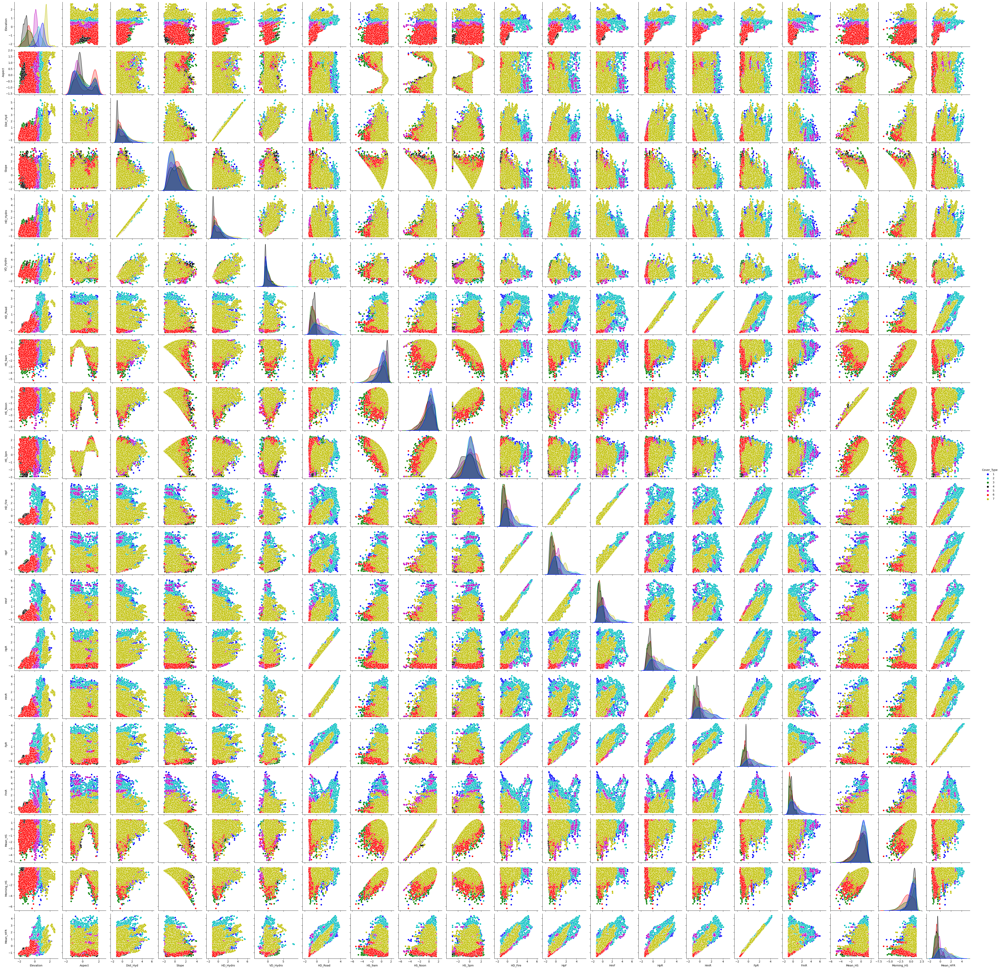

In [11]:
custom_palette = ["b", "c", "g", "k", "m", "r", "y"]
features = [
    "Elevation",
    "Aspect",
    "Distance_To_Hydrology",
    "Slope",
    "Horizontal_Distance_To_Hydrology",
    "Vertical_Distance_To_Hydrology",
    "Horizontal_Distance_To_Roadways",
    "Hillshade_9am",
    "Hillshade_Noon",
    "Hillshade_3pm",
    "Horizontal_Distance_To_Fire_Points",
    "Hyd_p_Fire",
    "Hyd_m_Fire",
    "Hyd_p_Road",
    "Hyd_m_Road",
    "Fire_p_Road",
    "Fire_m_Road",
    "Mean_Hillshade",
    "Morning_Hillshade",
    "Mean_Amenities",
    "Cover_Type",
]
labels = [
    "Elevation",
    "Aspect",
    "Dist_Hyd",
    "Slope",
    "HD_Hydro",
    "VD_Hydro",
    "HD_Road",
    "HS_9am",
    "HS_Noon",
    "HS_3pm",
    "HD_Fire",
    "HpF",
    "HmF",
    "HpR",
    "HmR",
    "FpR",
    "FmR",
    "Mean_HS",
    "Morning_HS",
    "Mean_HFR",
    "Cover_Type",
]

shorter_labels = dict(zip(features, labels))

corr_train = df_final[features].copy()
corr_train.rename(columns=shorter_labels, inplace=True)
axes = sns.pairplot(corr_train, hue="Cover_Type", palette=custom_palette)

In [12]:
# Highly Correlated Values
df_corr = corr_train.corr()
threshold = 0.5

corr_list = []
for i in range(0, 10):
    for j in range(i + 1, 10):
        if (df_corr.iloc[i, j] >= threshold and df_corr.iloc[i, j] < 1) or (
            df_corr.iloc[i, j] < 0 and df_corr.iloc[i, j] <= -threshold
        ):
            corr_list.append([df_corr.iloc[i, j], i, j])

corr_list = sorted(corr_list, key=lambda x: -abs(x[0]))

for k, i, j in corr_list:
    print("%s and %s = %.2f" % (labels[i], labels[j], k))

Dist_Hyd and HD_Hydro = 1.00
HS_9am and HS_3pm = -0.78
Dist_Hyd and VD_Hydro = 0.69
HD_Hydro and VD_Hydro = 0.65
Aspect and HS_3pm = 0.62
Slope and HS_Noon = -0.61
HS_Noon and HS_3pm = 0.61
Aspect and HS_9am = -0.59
Elevation and HD_Road = 0.58


# Soil Type Grouping

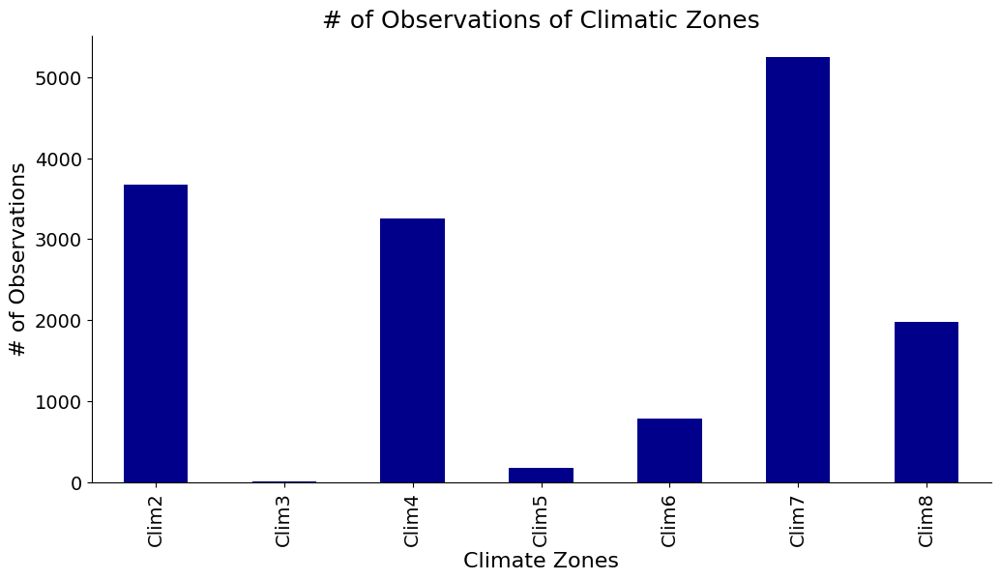

In [13]:
climatic_data = df_final[
    ["Clim2", "Clim3", "Clim4", "Clim5", "Clim6", "Clim7", "Clim8"]
]
climatic_data.sum().plot(kind="bar", figsize=(12, 6), color="darkblue")
plt.title("# of Observations of Climatic Zones", size=18)
plt.xlabel("Climate Zones", size=16)
plt.ylabel("# of Observations", size=16)
plt.xticks(rotation=90, size=14)
plt.yticks(size=14)

sns.despine()
plt.show()

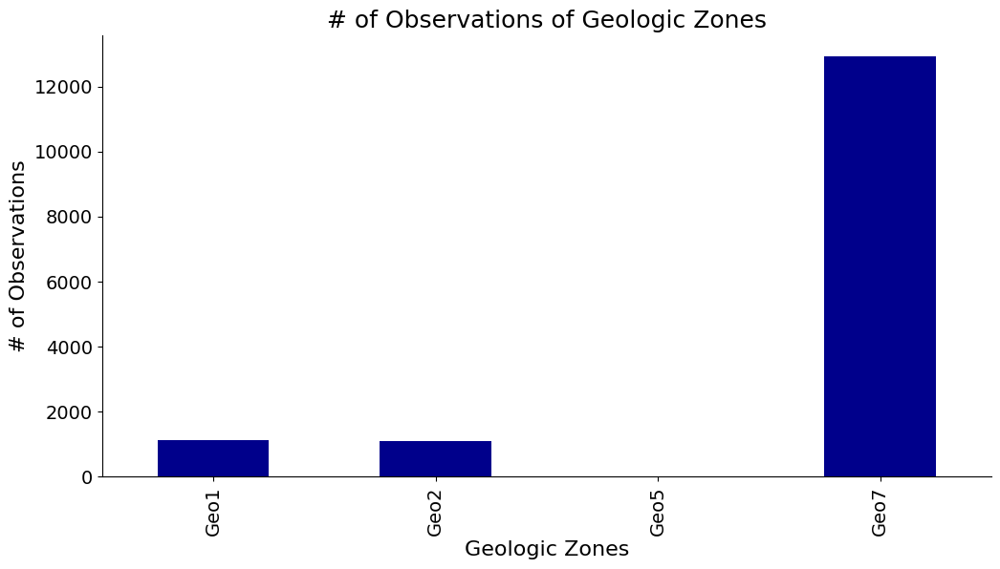

In [14]:
geologic_data = df_final[["Geo1", "Geo2", "Geo5", "Geo7"]]
geologic_data.sum().plot(kind="bar", figsize=(12, 6), color="darkblue")
plt.title("# of Observations of Geologic Zones", size=18)
plt.xlabel("Geologic Zones", size=16)
plt.ylabel("# of Observations", size=16)
plt.xticks(rotation=90, size=14)
plt.yticks(size=14)

sns.despine()
plt.show()

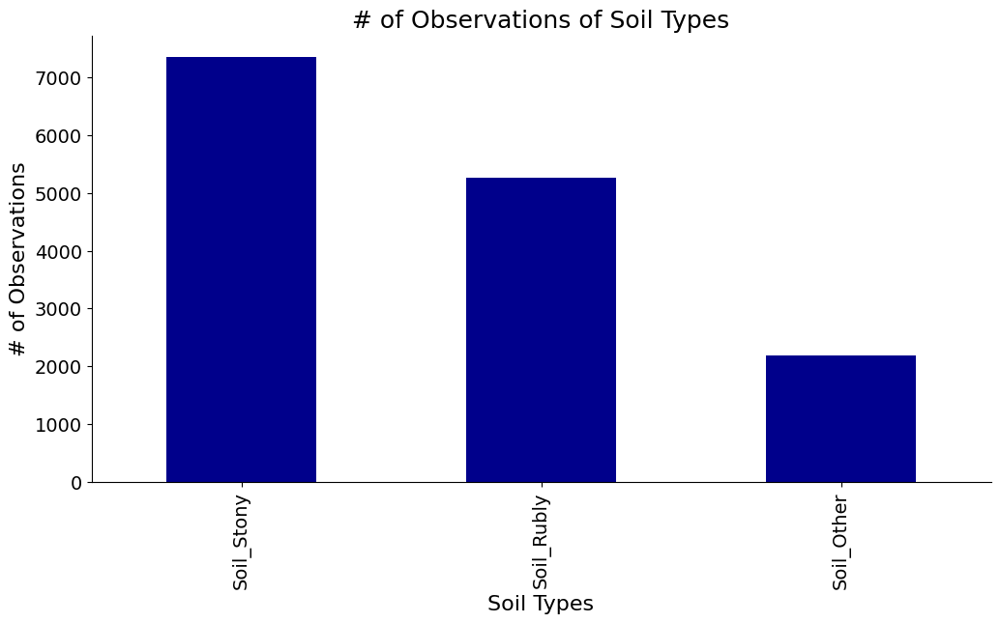

In [15]:
soil_data = df_final[["Soil_Stony", "Soil_Rubly", "Soil_Other"]]
soil_data.sum().plot(kind="bar", figsize=(12, 6), color="darkblue")
plt.title("# of Observations of Soil Types", size=18)
plt.xlabel("Soil Types", size=16)
plt.ylabel("# of Observations", size=16)
plt.xticks(rotation=90, size=14)
plt.yticks(size=14)

sns.despine()
plt.show()

# Hillshade - Apsect

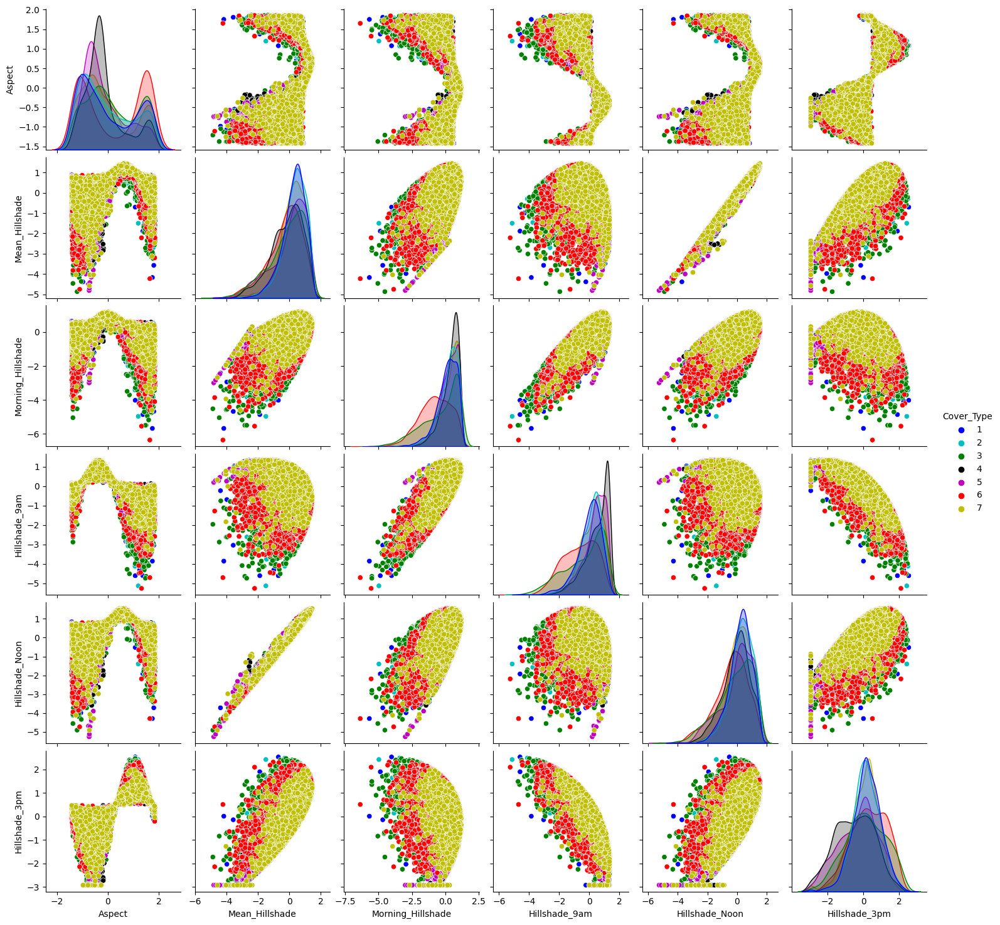

In [16]:
sns.pairplot(
    df_final[
        [
            "Aspect",
            "Mean_Hillshade",
            "Morning_Hillshade",
            "Hillshade_9am",
            "Hillshade_Noon",
            "Hillshade_3pm",
            "Cover_Type",
        ]
    ],
    hue="Cover_Type",
    palette=custom_palette,
)
plt.show()

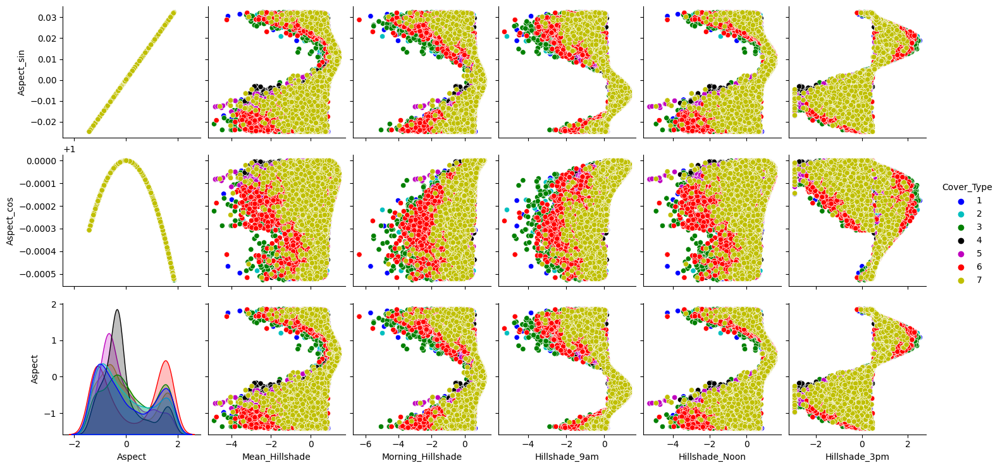

In [17]:
df_final["Aspect_sin"] = np.sin(2 * np.pi * df_final["Aspect"] / 360)
df_final["Aspect_cos"] = np.cos(2 * np.pi * df_final["Aspect"] / 360)
sns.pairplot(
    df_final,
    x_vars=[
        "Aspect",
        "Mean_Hillshade",
        "Morning_Hillshade",
        "Hillshade_9am",
        "Hillshade_Noon",
        "Hillshade_3pm",
    ],
    y_vars=["Aspect_sin", "Aspect_cos", "Aspect"],
    hue="Cover_Type",
    palette=custom_palette,
)
plt.show()

In [18]:
correlation = df_final.corr()
aspect_correlation = correlation["Aspect"].sort_values()
abs_correlation = aspect_correlation.abs()
sorted_correlation = abs_correlation.sort_values(ascending=False)
print(sorted_correlation.head(10))

Aspect               1.000000
Aspect_sin           1.000000
Hillshade_3pm        0.624801
Hillshade_9am        0.590290
Aspect_cos           0.497786
Aspect_E             0.465743
Aspect_W             0.449241
Mean_Hillshade       0.345883
Hillshade_Noon       0.313553
Morning_Hillshade    0.287658
Name: Aspect, dtype: float64


In [19]:
aspect_sin_correlation = correlation["Aspect_sin"].sort_values()
abs_correlation = aspect_sin_correlation.abs()
sorted_correlation = abs_correlation.sort_values(ascending=False)
print(sorted_correlation.head(10))

Aspect_sin           1.000000
Aspect               1.000000
Hillshade_3pm        0.624816
Hillshade_9am        0.590296
Aspect_cos           0.497768
Aspect_E             0.465757
Aspect_W             0.449262
Mean_Hillshade       0.345902
Hillshade_Noon       0.313573
Morning_Hillshade    0.287650
Name: Aspect_sin, dtype: float64


In [20]:
aspect_cos_correlation = correlation["Aspect_cos"].sort_values()
abs_correlation = aspect_cos_correlation.abs()
sorted_correlation = abs_correlation.sort_values(ascending=False)
print(sorted_correlation.head(10))

Aspect_cos           1.000000
Aspect_N             0.780281
Morning_Hillshade    0.679120
Hillshade_9am        0.668300
Aspect               0.497786
Aspect_sin           0.497768
Aspect_E             0.470646
Aspect_S             0.457434
Hillshade_3pm        0.443047
Soil_Type10          0.321656
Name: Aspect_cos, dtype: float64


In [21]:
print(
    aspect_correlation["Hillshade_9am"],
    aspect_sin_correlation["Hillshade_9am"],
    aspect_cos_correlation["Hillshade_9am"],
)

-0.5902897395198086 -0.5902961047458377 0.6683001493124395


# Correlation with target

In [22]:
corr_train["Aspect_sin"] = df_final["Aspect_sin"]
corr_train["Aspect_cos"] = df_final["Aspect_cos"]
correlation = corr_train.corr()
target_correlation = correlation["Cover_Type"].sort_values()
abs_correlation = target_correlation.abs()
sorted_correlation = abs_correlation.sort_values(ascending=False)
print(sorted_correlation)

Cover_Type    1.000000
FmR           0.217076
FpR           0.128087
Mean_HFR      0.125420
HmR           0.122400
HD_Road       0.119576
HpR           0.115382
HD_Fire       0.099413
HmF           0.098654
HpF           0.095952
HS_Noon       0.093008
Mean_HS       0.092634
Slope         0.086536
VD_Hydro      0.070615
Morning_HS    0.068312
HS_3pm        0.047372
Aspect_cos    0.028212
HS_9am        0.015570
Elevation     0.014241
Aspect        0.009439
Aspect_sin    0.009437
HD_Hydro      0.004266
Dist_Hyd      0.000025
Name: Cover_Type, dtype: float64


## Feature selection

### PCA

In [23]:
X = df_final.drop('Cover_Type', axis=1)
y = df_final['Cover_Type']

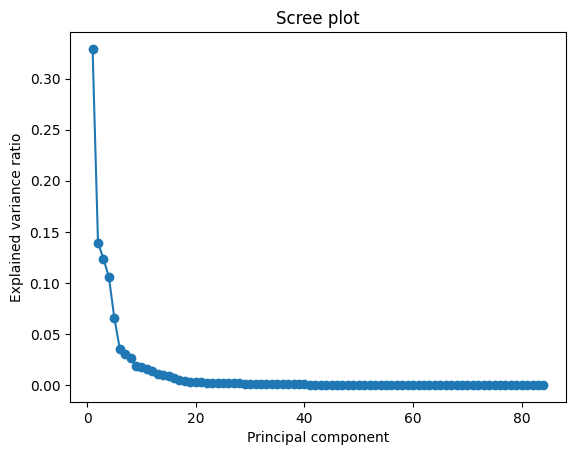

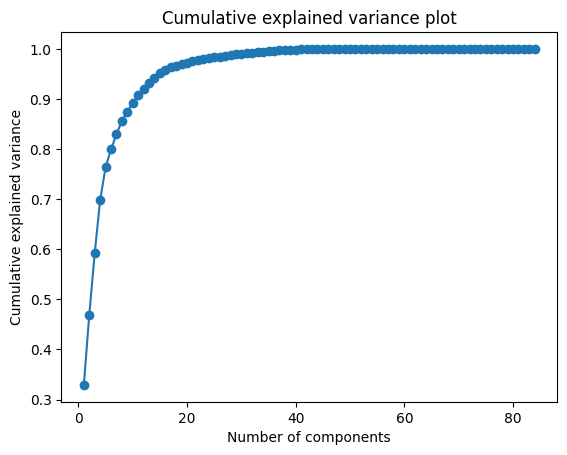

Number of components to explain 95% of the variance: 15


In [24]:
from sklearn.decomposition import PCA

# Create a PCA object with no components specified
pca = PCA()

# Fit the PCA model to the data
pca.fit(X)

# Calculate the explained variance ratio for each component
explained_var = pca.explained_variance_ratio_

# Plot the scree plot to visualize the explained variance ratio
import matplotlib.pyplot as plt
plt.plot(range(1, len(explained_var)+1), explained_var, marker='o')
plt.xlabel('Principal component')
plt.ylabel('Explained variance ratio')
plt.title('Scree plot')
plt.show()

# Calculate the cumulative explained variance
cumulative_var = np.cumsum(explained_var)

# Plot the cumulative explained variance to determine the optimal number of components
plt.plot(range(1, len(cumulative_var)+1), cumulative_var, marker='o')
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')
plt.title('Cumulative explained variance plot')
plt.show()

# Choose the optimal number of components based on the cumulative explained variance plot
n_components = np.where(cumulative_var >= 0.95)[0][0] + 1
print(f"Number of components to explain 95% of the variance: {n_components}")

# Fit a new PCA model using the optimal number of components
pca = PCA(n_components=n_components)
X_pca = pca.fit_transform(X)

### XGB Feature selection

In [25]:
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder

X = X.drop(['Wilderness_Area1',
       'Wilderness_Area2', 'Wilderness_Area3', 'Wilderness_Area4',
       'Soil_Type1', 'Soil_Type2', 'Soil_Type3', 'Soil_Type4', 'Soil_Type5',
       'Soil_Type6', 'Soil_Type7', 'Soil_Type8', 'Soil_Type9', 'Soil_Type10',
       'Soil_Type11', 'Soil_Type12', 'Soil_Type13', 'Soil_Type14',
       'Soil_Type15', 'Soil_Type16', 'Soil_Type17', 'Soil_Type18',
       'Soil_Type19', 'Soil_Type20', 'Soil_Type21', 'Soil_Type22',
       'Soil_Type23', 'Soil_Type24', 'Soil_Type25', 'Soil_Type26',
       'Soil_Type27', 'Soil_Type28', 'Soil_Type29', 'Soil_Type30',
       'Soil_Type31', 'Soil_Type32', 'Soil_Type33', 'Soil_Type34',
       'Soil_Type35', 'Soil_Type36', 'Soil_Type37', 'Soil_Type38',
       'Soil_Type39', 'Soil_Type40','Aspect_N', 'Aspect_E',
       'Aspect_S', 'Aspect_W', 'Clim2', 'Clim3', 'Clim4', 'Clim5', 'Clim6',
       'Clim7', 'Clim8', 'Geo1', 'Geo2', 'Geo5', 'Geo7', 'Soil_Stony',
       'Soil_Rubly', 'Soil_Other'], axis=1)
le = LabelEncoder()
y = le.fit_transform(y)
# Instantiate an XGBoost classifier
xgb_clf = xgb.XGBClassifier()

# Fit the XGBoost classifier to the training data
xgb_clf.fit(X, y)


XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
              learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=100,
              n_jobs=0, num_parallel_tree=1, objective='multi:softprob',
              predictor='auto', random_state=0, reg_alpha=0, ...)

In [26]:
importances = xgb_clf.feature_importances_
feature_names = xgb_clf.get_booster().feature_names

# Create a list of tuples containing feature importance and name
feature_importances = [(importance, name) for importance, name in zip(importances, feature_names)]

# Sort the list of tuples in descending order based on feature importance
feature_importances = sorted(feature_importances, reverse=True)

# Print the list of feature importances and names
for importance, name in feature_importances:
    print(name, importance)

Elevation 0.28658983
Morning_Hillshade 0.07329766
Distance_To_Hydrology 0.06708609
Aspect_cos 0.05725354
Fire_p_Road 0.04385108
Hyd_m_Road 0.041372277
Mean_Amenities 0.036876142
Horizontal_Distance_To_Hydrology 0.03415566
Horizontal_Distance_To_Roadways 0.034042623
Hyd_p_Fire 0.033556473
Hyd_m_Fire 0.033259753
Fire_m_Road 0.033197418
Hillshade_9am 0.028986597
Hyd_p_Road 0.02894831
Hillshade_Noon 0.027578253
Hillshade_3pm 0.02405766
Horizontal_Distance_To_Fire_Points 0.023745216
Slope 0.023550346
Mean_Hillshade 0.023262851
Vertical_Distance_To_Hydrology 0.023156429
Aspect 0.022175943
Aspect_sin 0.0
